In [1]:
import os
import numpy as np
import pandas as pd
import plotly.express as px
import umap
from concurrent.futures import ThreadPoolExecutor, as_completed
from plotly.colors import hex_to_rgb
import json

/home/embeddings_env/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
def load_single_embedding(file):
    if file.endswith('.npy'):
        return np.load(file, mmap_mode='r')
    return None

def load_embeddings(files):
    valid_files = [f for f in files if f.endswith('.npy')]
    
    with ThreadPoolExecutor() as executor:
        futures = [executor.submit(load_single_embedding, file) for file in valid_files]
        embeddings = [future.result() for future in as_completed(futures) if future.result() is not None]
    
    return np.array(embeddings)

def get_split(split, embedding, folders):
    files = []
    y = []
    for folder in folders:
        if split == 'all':
            for split_aux in ['train', 'val', 'test']:
                with open(f'/data/{folder}/{split_aux}.txt', 'r') as f:
                    folder_files = f.read().splitlines()
                    files.extend([f'/data/{folder}/audio/embeddings/{embedding}/{file}.npy' for file in folder_files])
                    y.extend([folder] * len(folder_files))
        else:
            with open(f'/data/{folder}/{split}.txt', 'r') as f:
                folder_files = f.read().splitlines()
                if split=='test':
                    folder_files = folder_files[:1000]
                files.extend([f'/data/{folder}/audio/embeddings/{embedding}/{file}.npy' for file in folder_files])
                y.extend([folder] * len(folder_files))
    
    X = load_embeddings(files)
    y = np.array(y)
    return X, y, files

def get_url(file):
    id = file.split('/')[-1].split('.')[0]
    if 'lastfm' in file:
        metadata = json.load(open(file))
        return metadata['youtube_url']
    elif 'suno' in file:
        return f'https://suno.com/song/{id}'
    elif 'udio' in file:
        return f'https://www.udio.com/songs/{id}'

def get_all_urls(files):
    with ThreadPoolExecutor() as executor:
        futures = [executor.submit(get_url, file) for file in files]
        urls = [future.result() for future in as_completed(futures)]
    
    return urls

# Convert hex to rgba alpha
def hex_to_rgba(hex_color, alpha=0.6):
    rgb = hex_to_rgb(hex_color)
    return f"rgba{str(rgb).replace(')', f', {alpha})')}"

In [3]:
folders = ['suno', 'udio', 'lastfm']

if os.path.exists('clap-laion-music_all.npz'):
    data = np.load('clap-laion-music_all.npz')
    embeddings = data['embeddings']
    y = data['y']
    emb_files = data['emb_files']
    audio_files = [f.replace('audio/embeddings/clap-laion-music', 'audio') for f in emb_files]
    audio_files = [f.replace('.npy', '.mp3') for f in audio_files]
else:
    embeddings, y, emb_files = get_split('all', 'clap-laion-music', folders)
    audio_files = [f.replace('audio/embeddings/clap-laion-music', 'audio') for f in emb_files]
    audio_files = [f.replace('.npy', '.mp3') for f in audio_files]
    # save embeddings, y and emb_files in join numpy z
    np.savez('clap-laion-music_all.npz', embeddings=embeddings, y=y, emb_files=emb_files)


In [4]:
metadata_files = [f.replace('audio/embeddings/clap-laion-music', 'metadata').replace('.npy', '.json') for f in emb_files]
urls = get_all_urls(metadata_files)

Running UMAP with min_dist=0.1, n_neigh=5, metric=euclidean


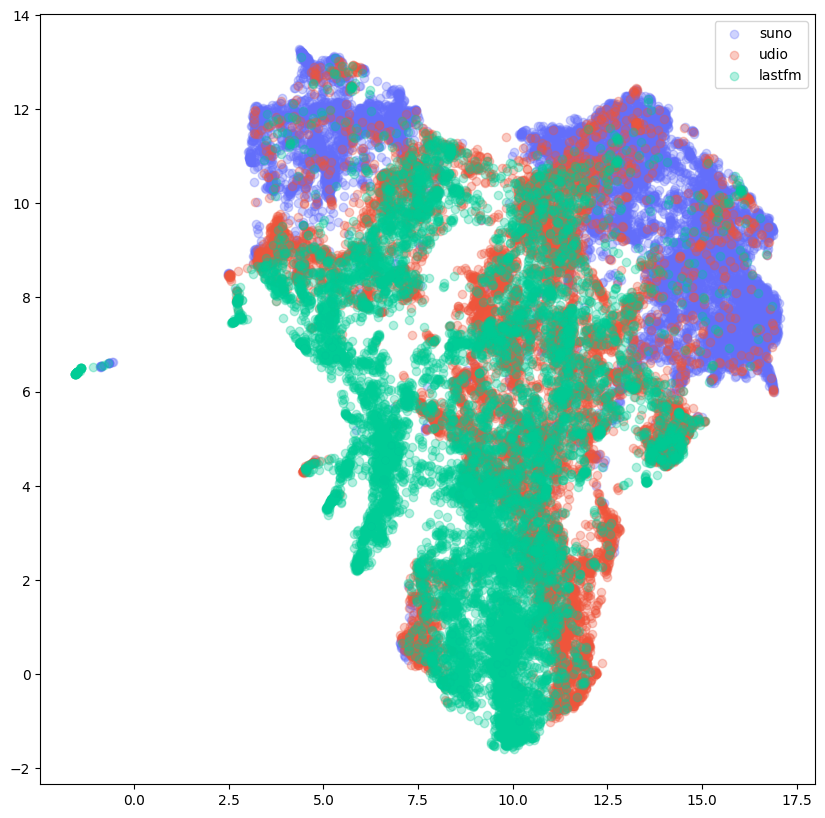

Running UMAP with min_dist=0.1, n_neigh=5, metric=manhattan


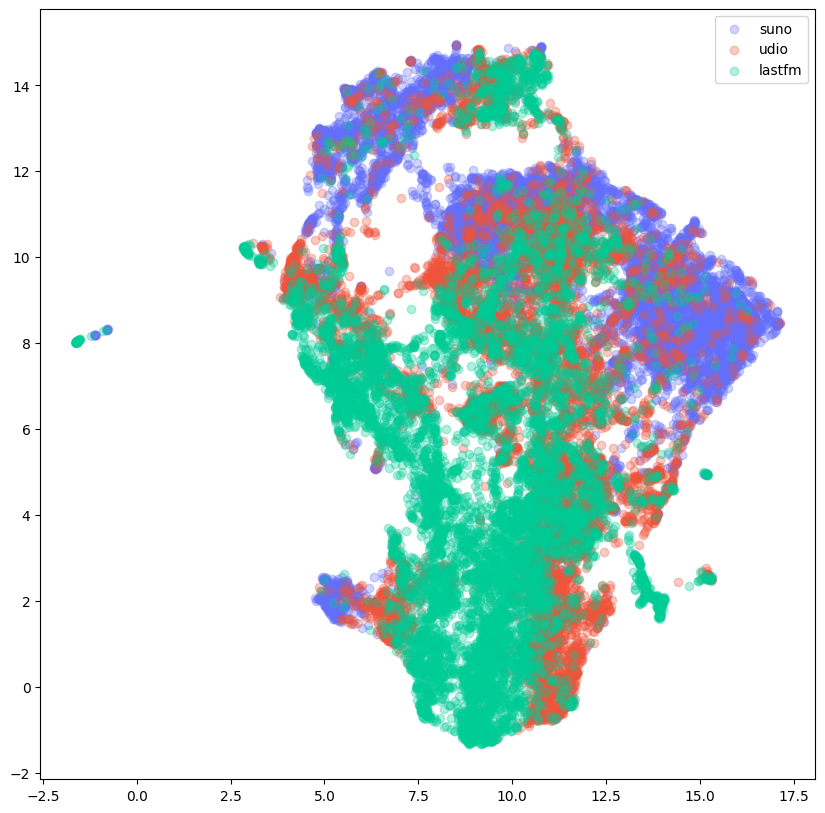

Running UMAP with min_dist=0.1, n_neigh=5, metric=cosine


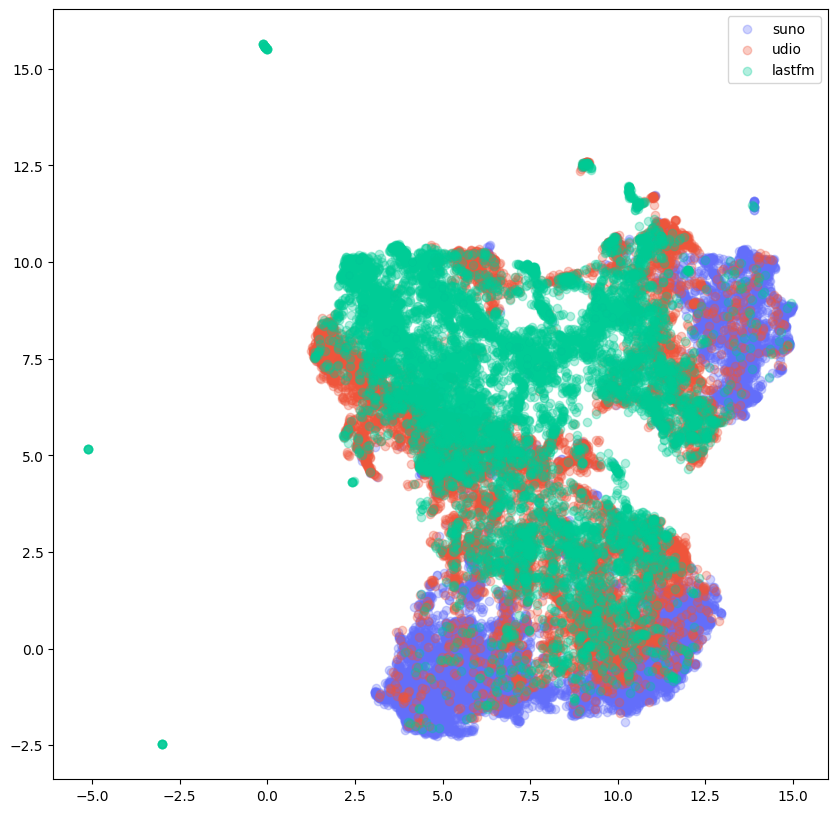

Running UMAP with min_dist=0.1, n_neigh=5, metric=correlation


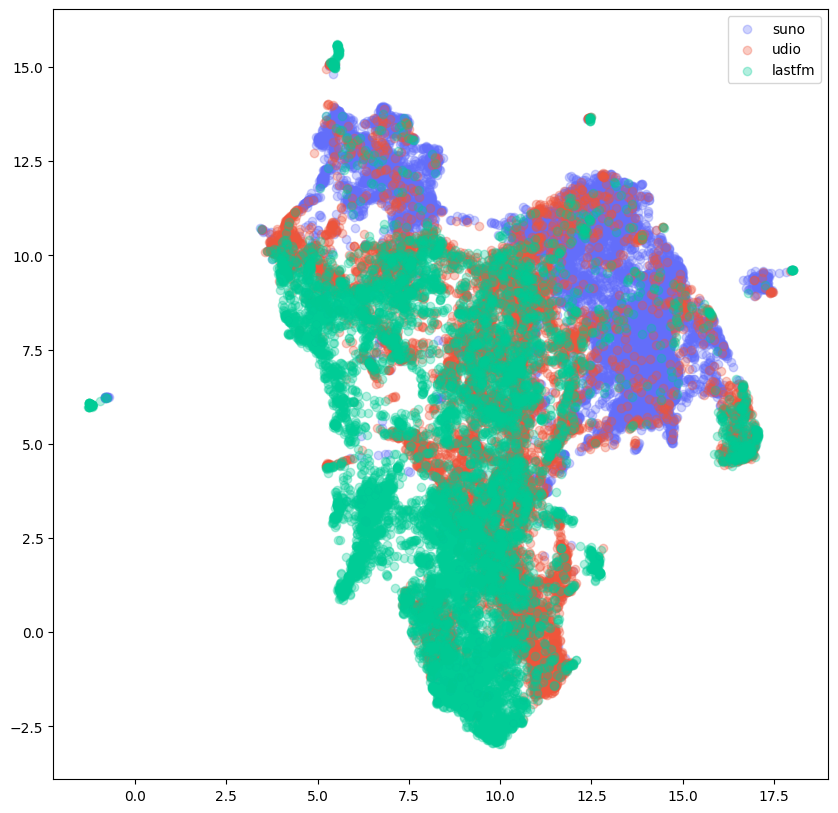

Running UMAP with min_dist=0.1, n_neigh=15, metric=euclidean


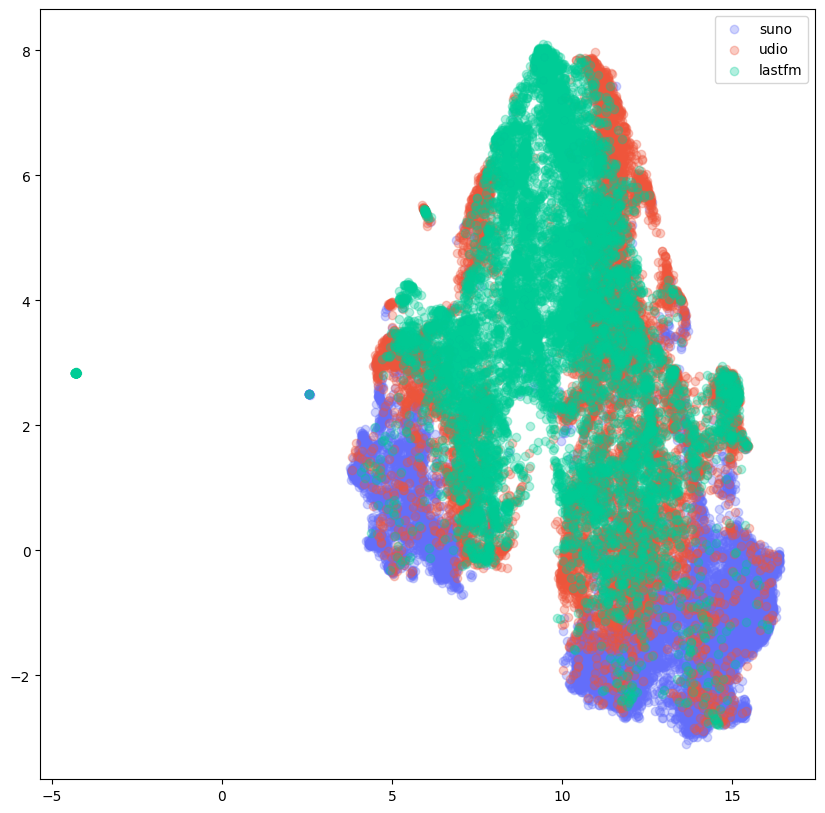

Running UMAP with min_dist=0.1, n_neigh=15, metric=manhattan


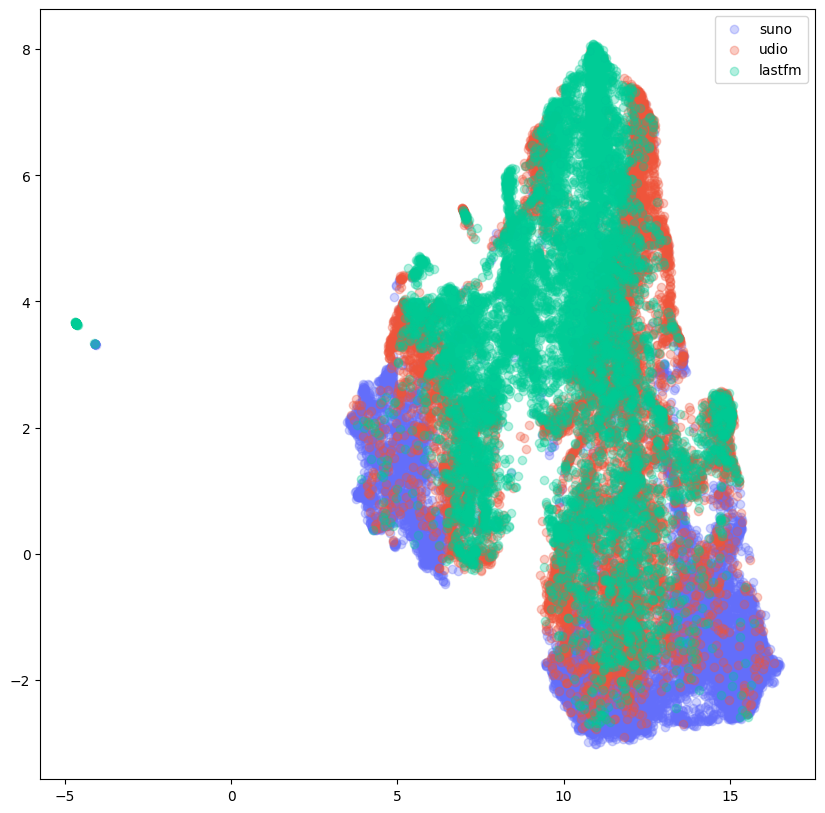

Running UMAP with min_dist=0.1, n_neigh=15, metric=cosine


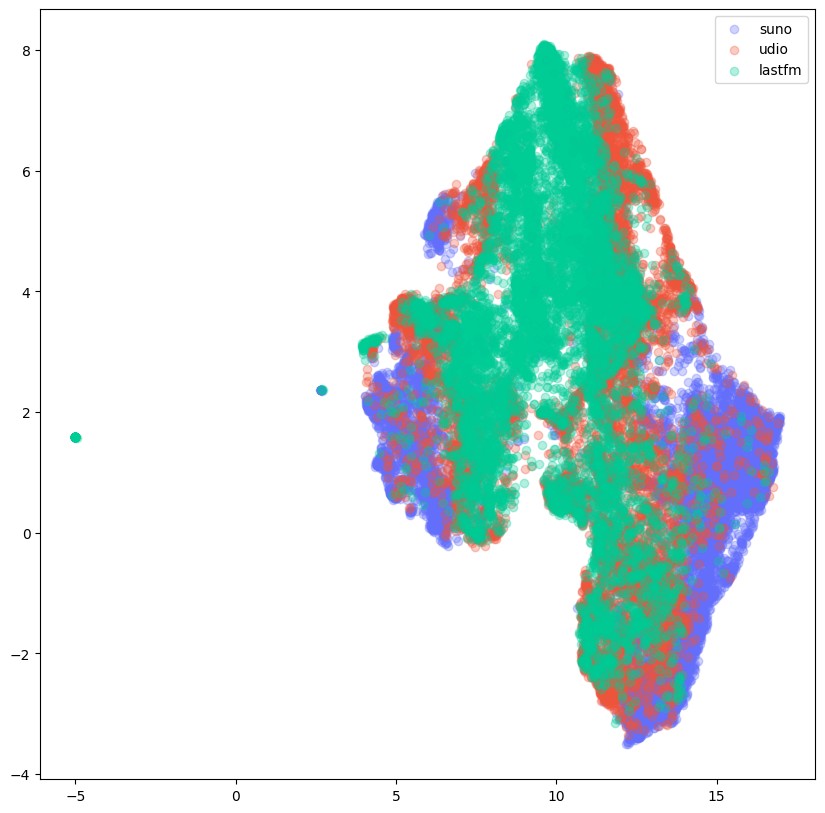

Running UMAP with min_dist=0.1, n_neigh=15, metric=correlation


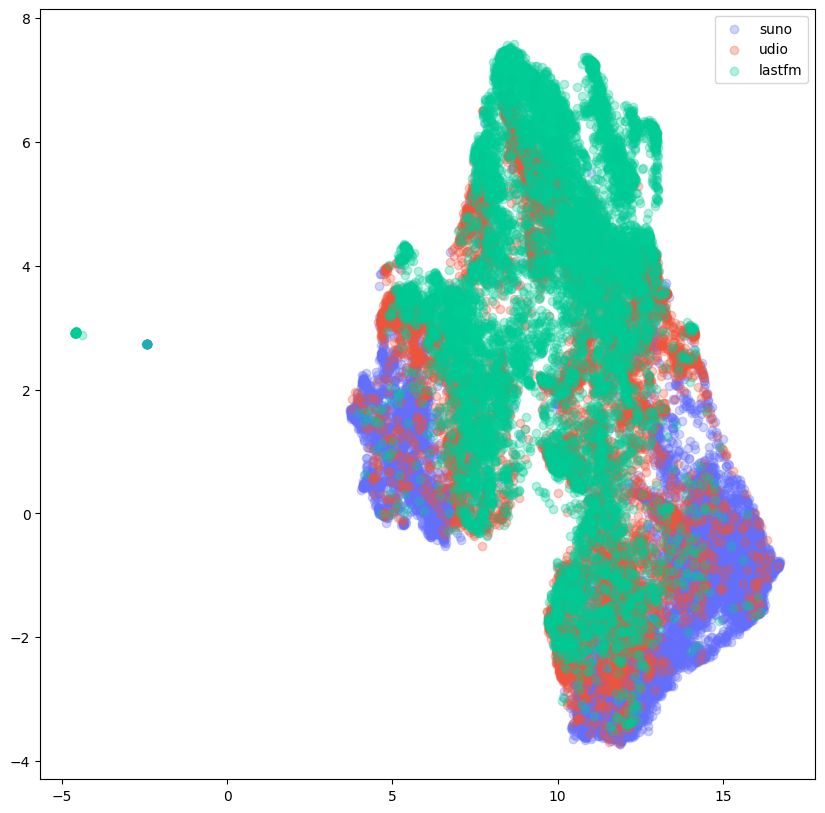

Running UMAP with min_dist=0.1, n_neigh=30, metric=euclidean


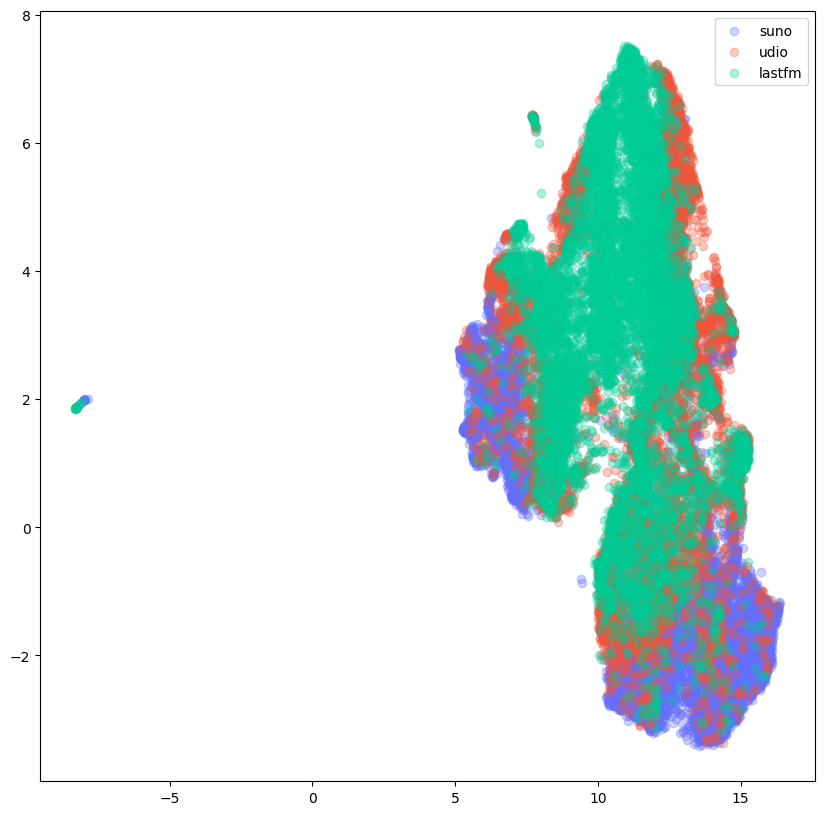

Running UMAP with min_dist=0.1, n_neigh=30, metric=manhattan


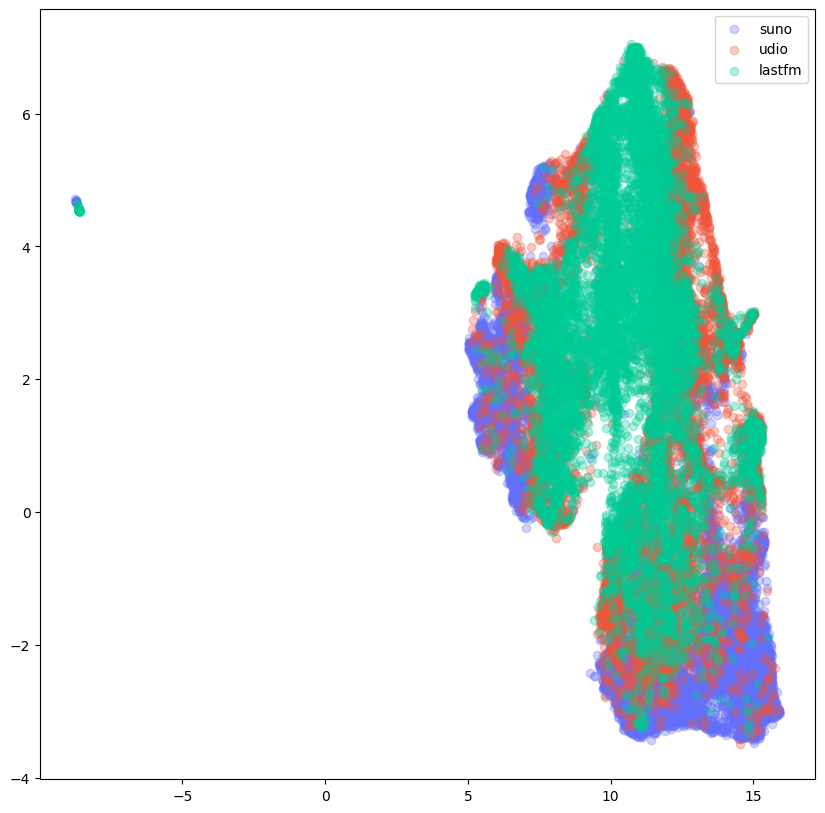

Running UMAP with min_dist=0.1, n_neigh=30, metric=cosine


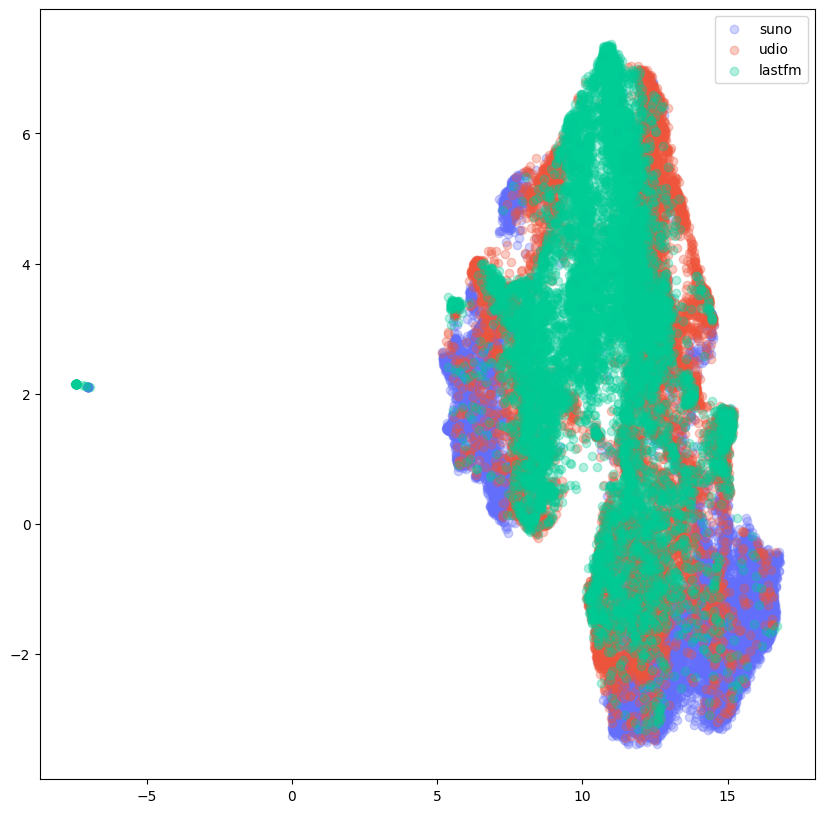

Running UMAP with min_dist=0.1, n_neigh=30, metric=correlation


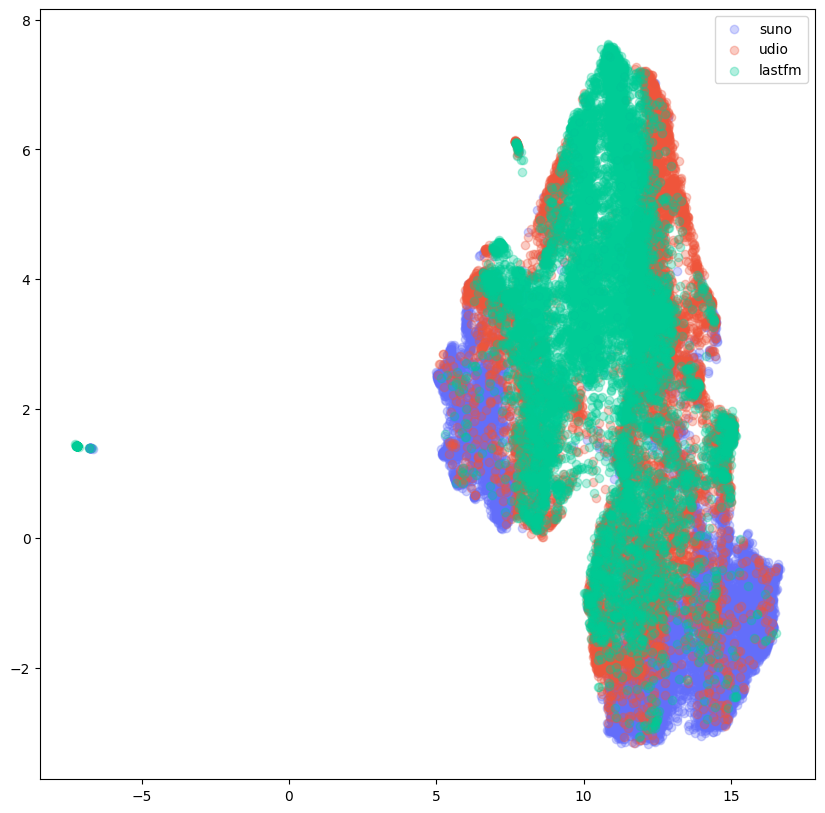

Running UMAP with min_dist=0.5, n_neigh=5, metric=euclidean


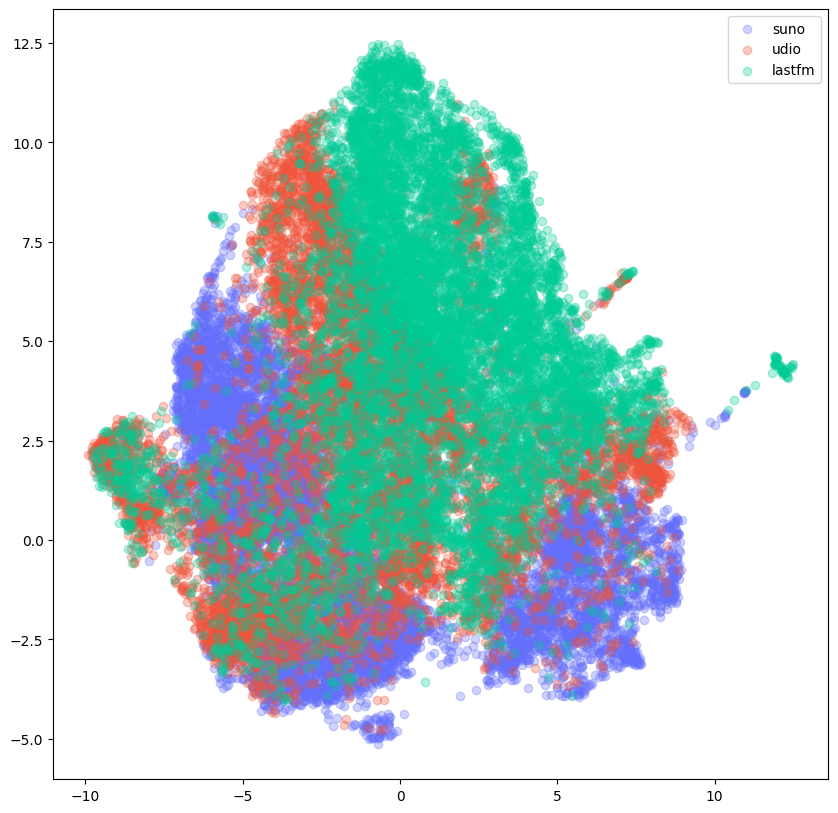

Running UMAP with min_dist=0.5, n_neigh=5, metric=manhattan


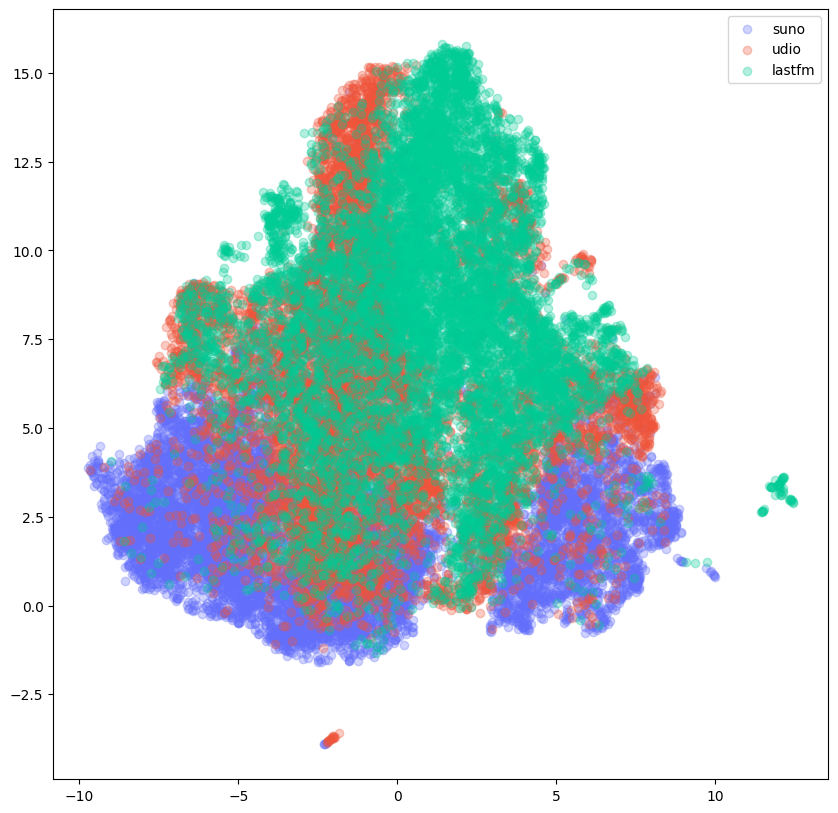

Running UMAP with min_dist=0.5, n_neigh=5, metric=cosine


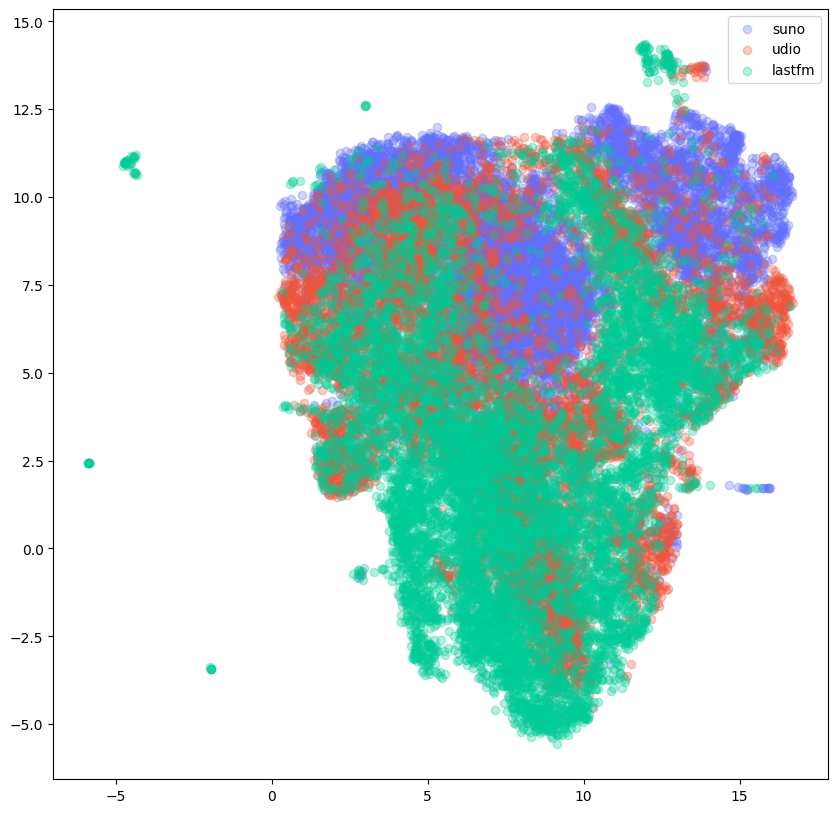

Running UMAP with min_dist=0.5, n_neigh=5, metric=correlation


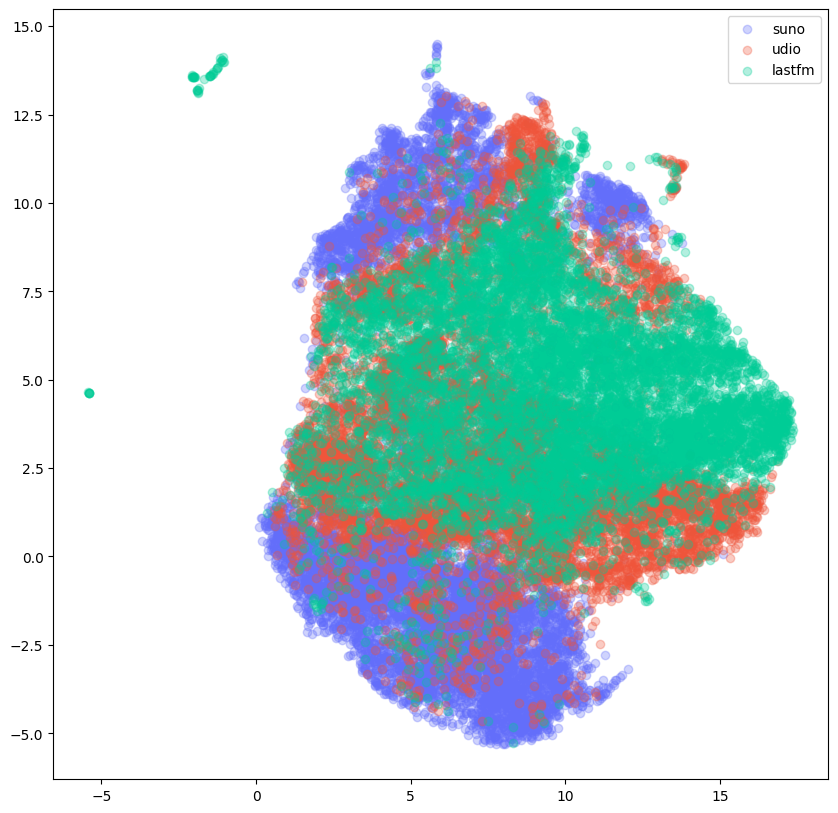

Running UMAP with min_dist=0.5, n_neigh=15, metric=euclidean


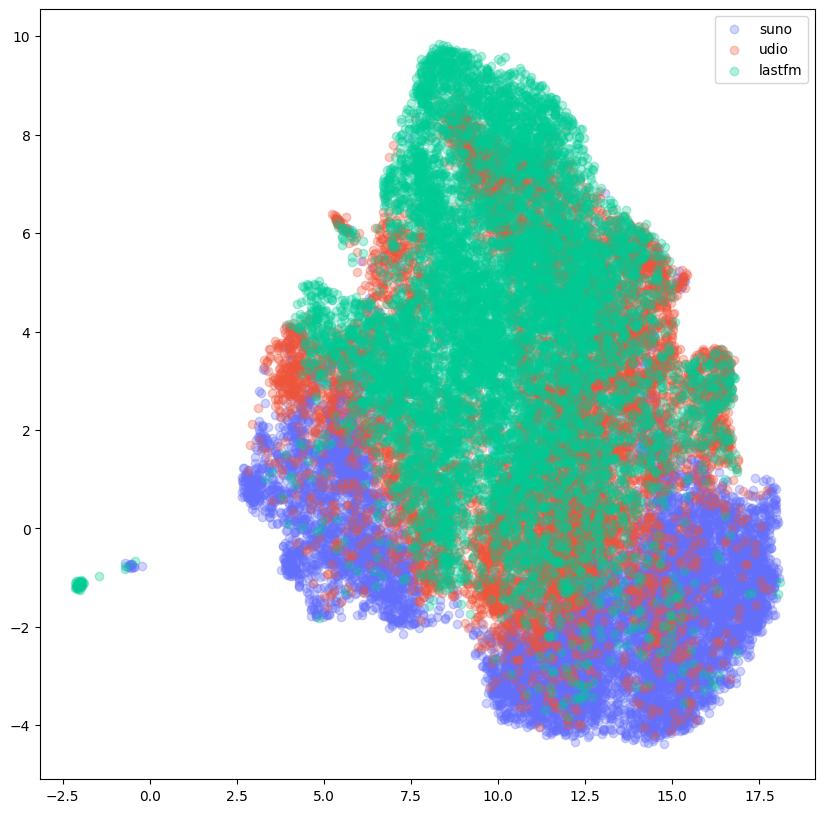

Running UMAP with min_dist=0.5, n_neigh=15, metric=manhattan


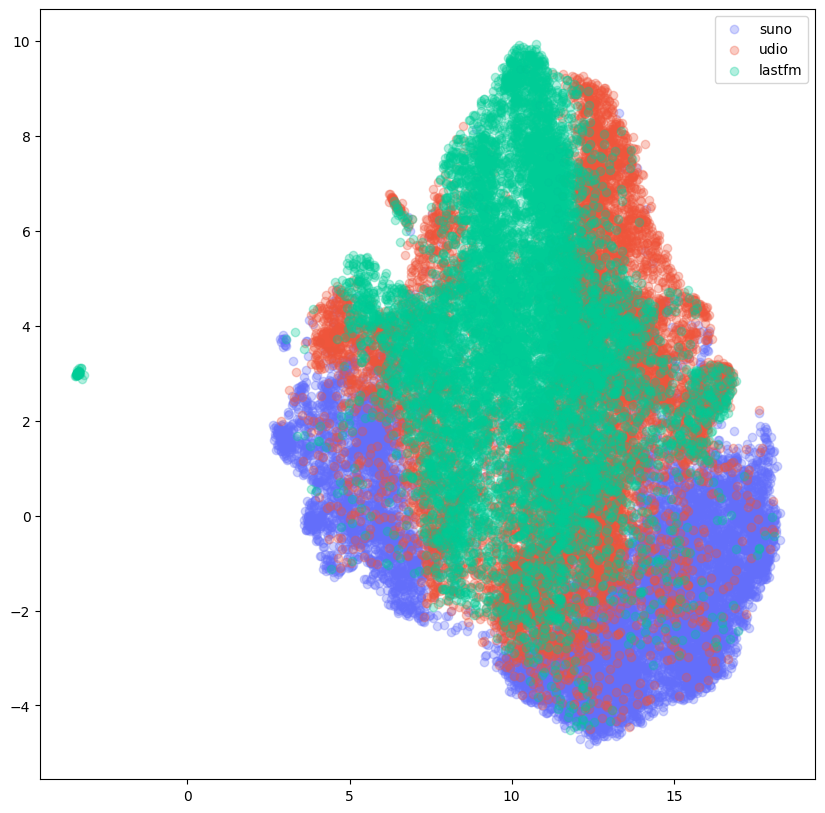

Running UMAP with min_dist=0.5, n_neigh=15, metric=cosine


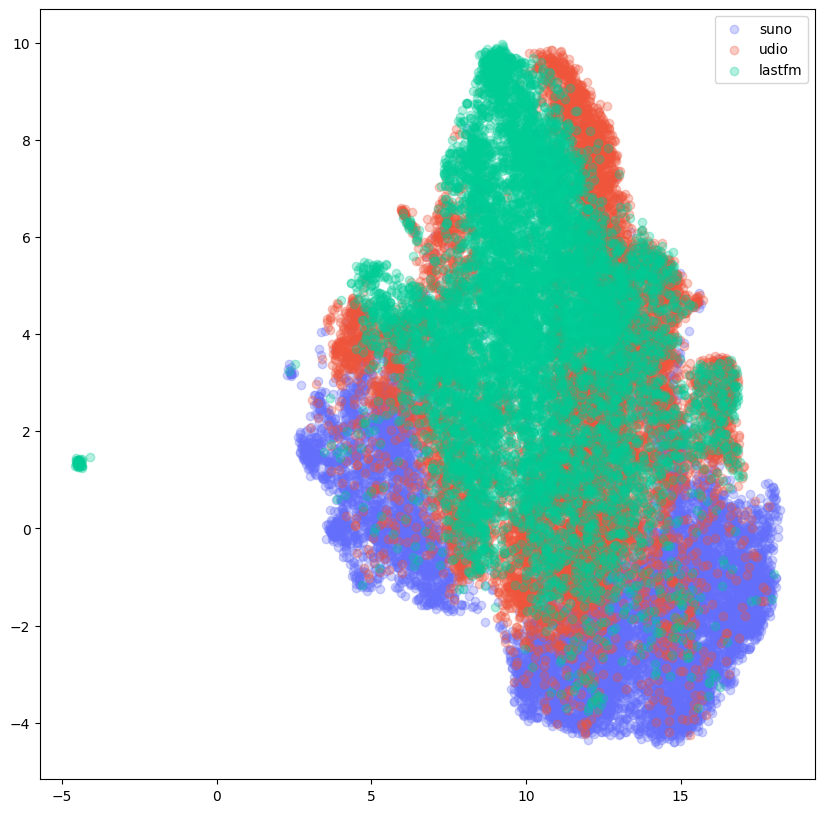

Running UMAP with min_dist=0.5, n_neigh=15, metric=correlation


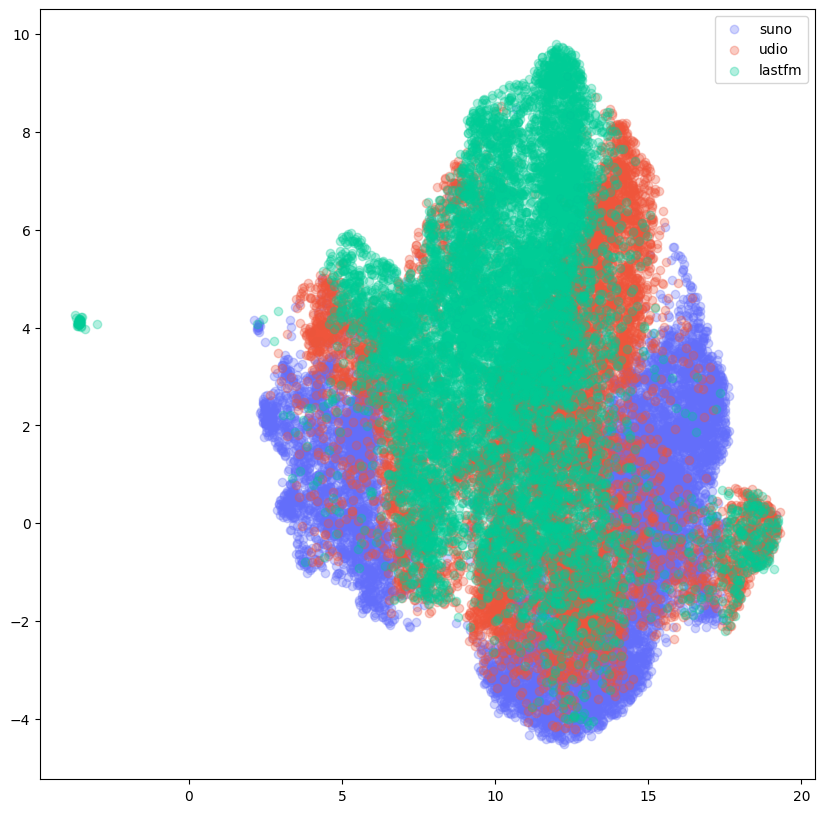

Running UMAP with min_dist=0.5, n_neigh=30, metric=euclidean


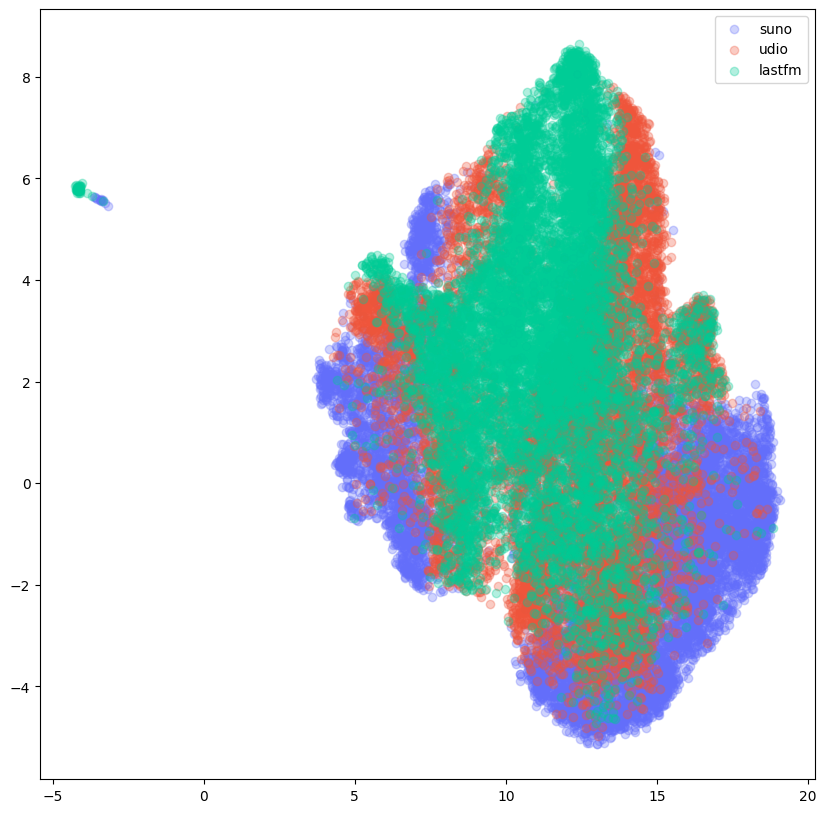

Running UMAP with min_dist=0.5, n_neigh=30, metric=manhattan


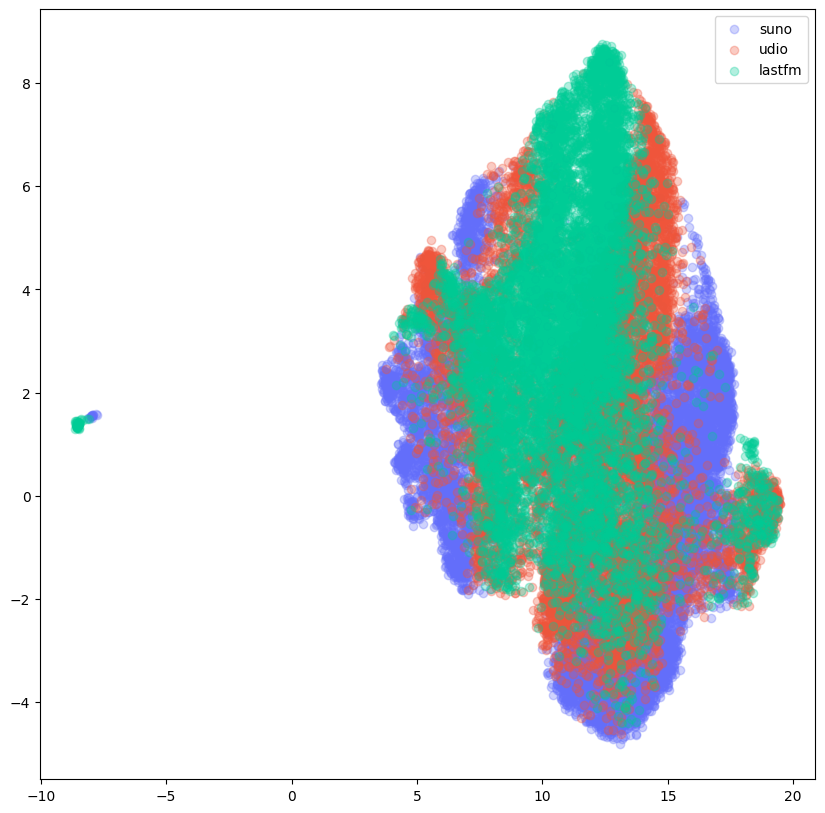

Running UMAP with min_dist=0.5, n_neigh=30, metric=cosine


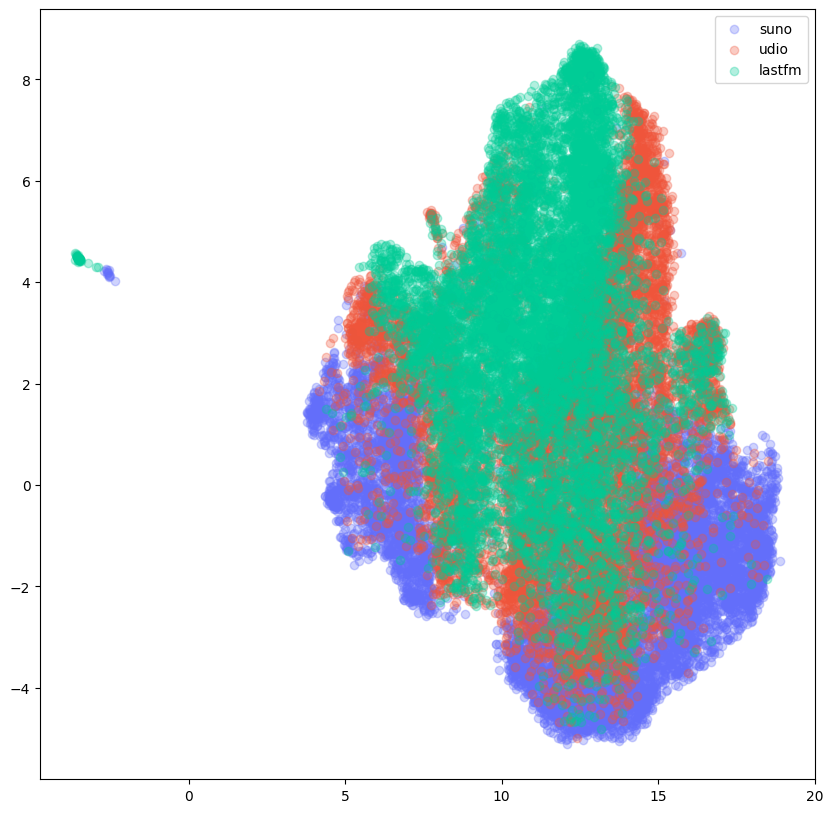

Running UMAP with min_dist=0.5, n_neigh=30, metric=correlation


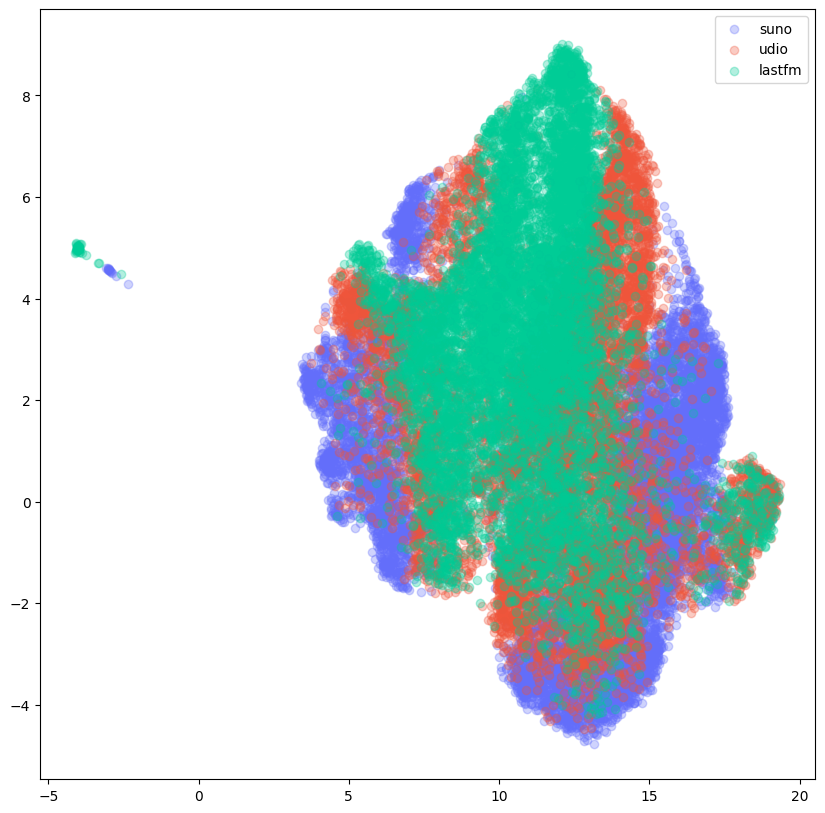

Running UMAP with min_dist=0.9, n_neigh=5, metric=euclidean


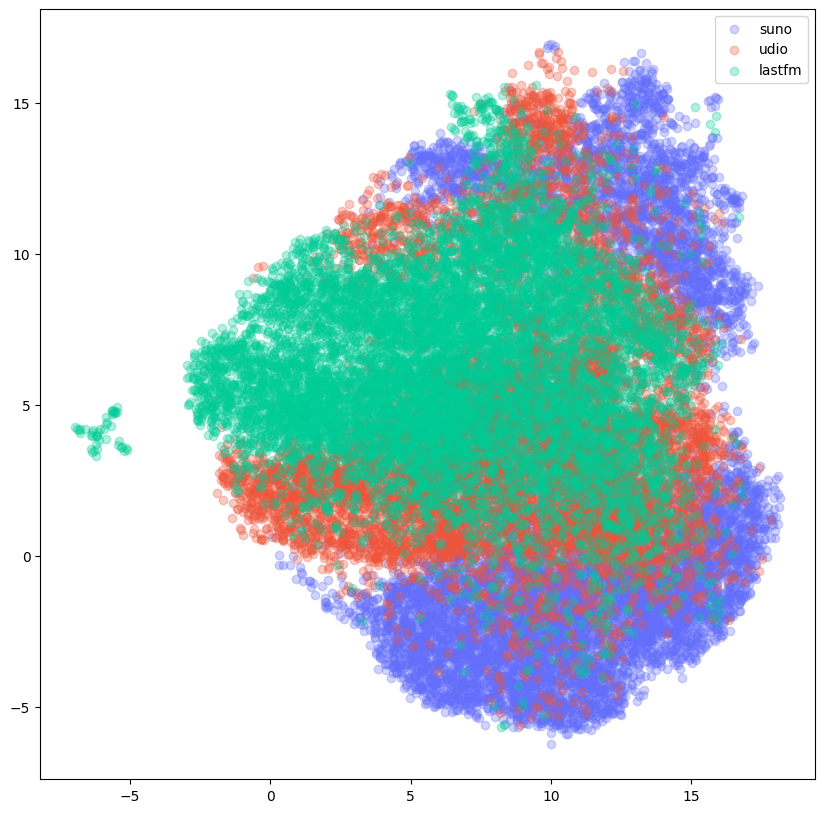

Running UMAP with min_dist=0.9, n_neigh=5, metric=manhattan


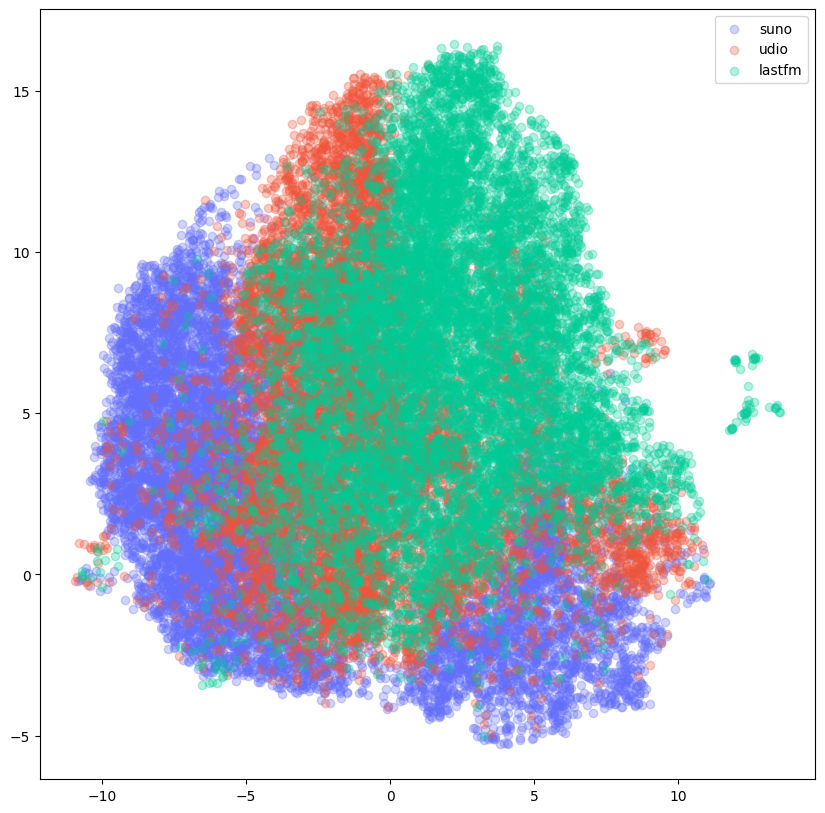

Running UMAP with min_dist=0.9, n_neigh=5, metric=cosine


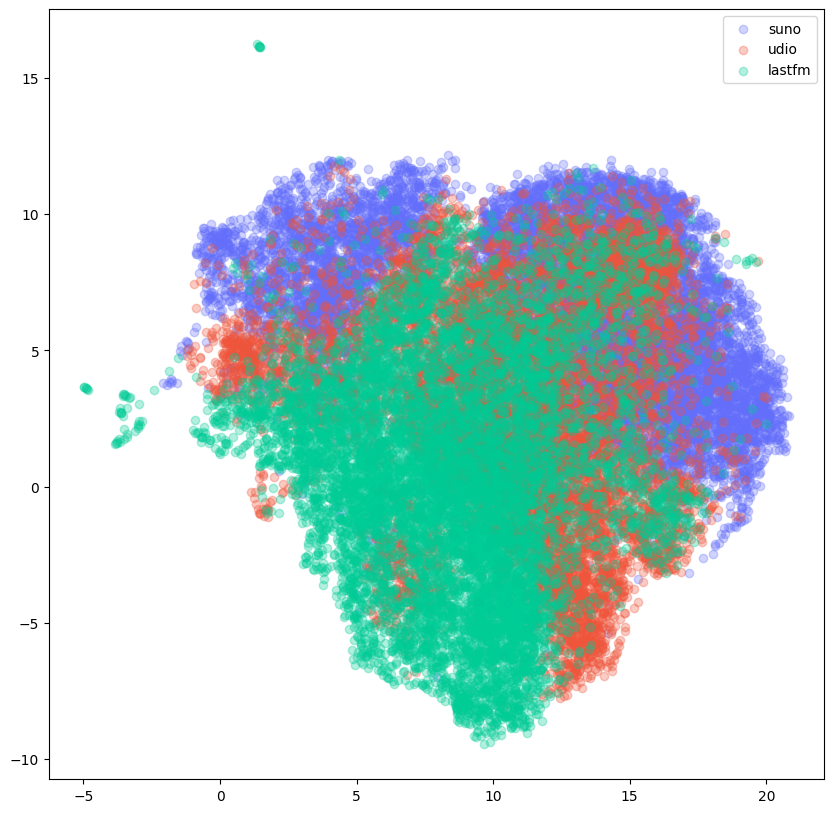

Running UMAP with min_dist=0.9, n_neigh=5, metric=correlation


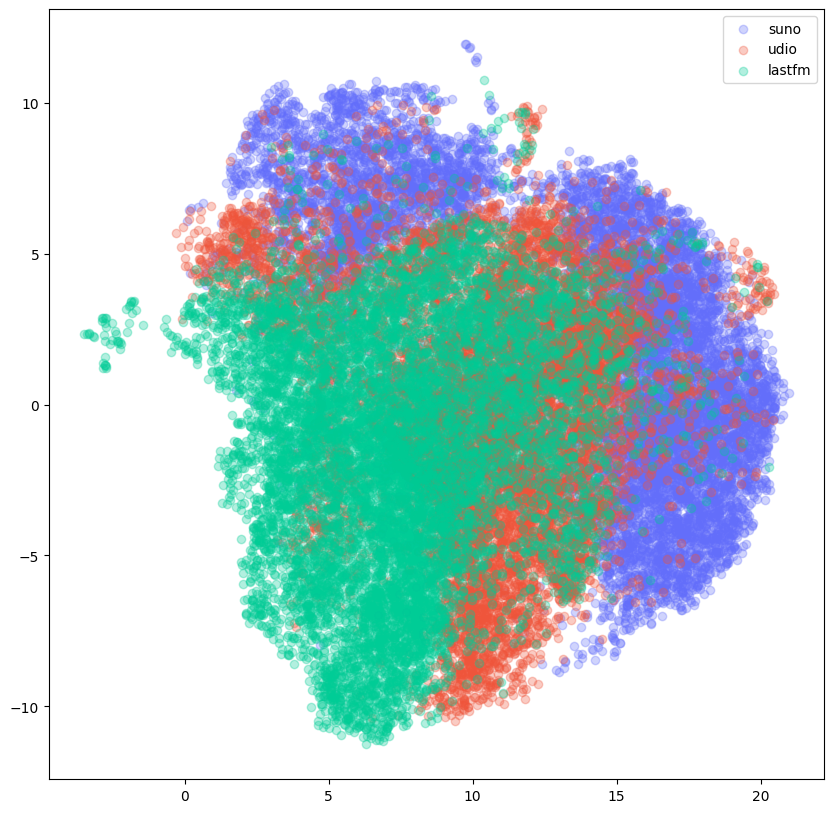

Running UMAP with min_dist=0.9, n_neigh=15, metric=euclidean


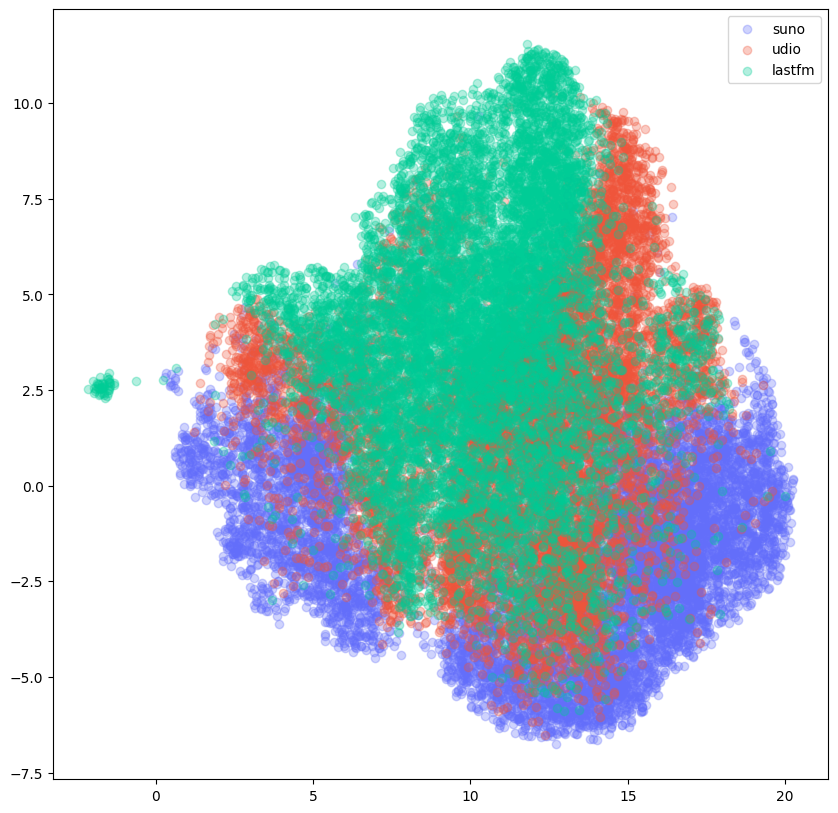

Running UMAP with min_dist=0.9, n_neigh=15, metric=manhattan


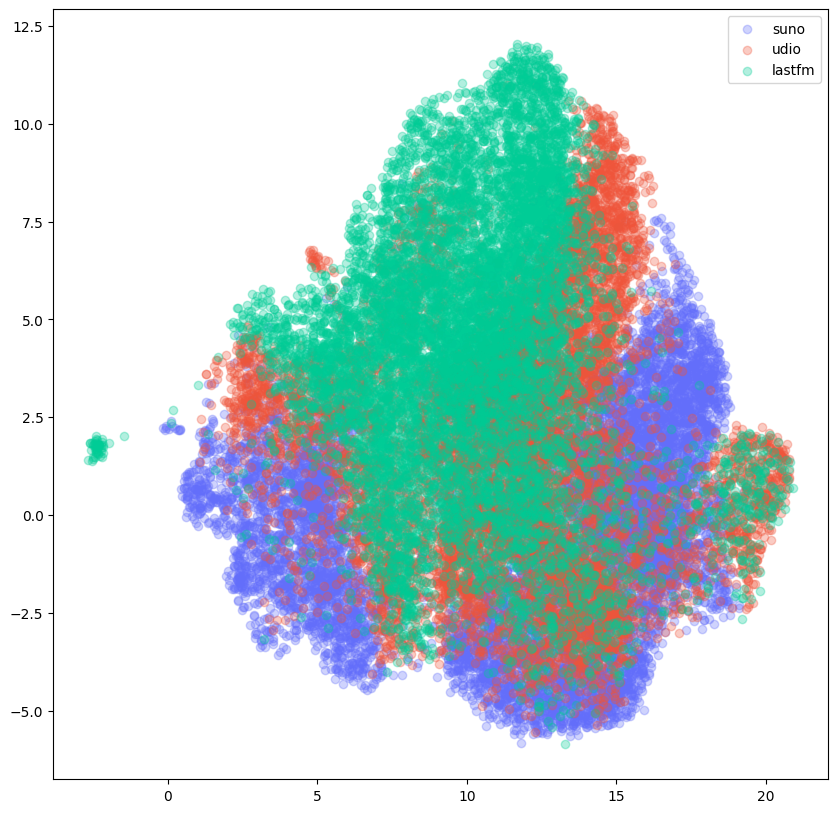

Running UMAP with min_dist=0.9, n_neigh=15, metric=cosine


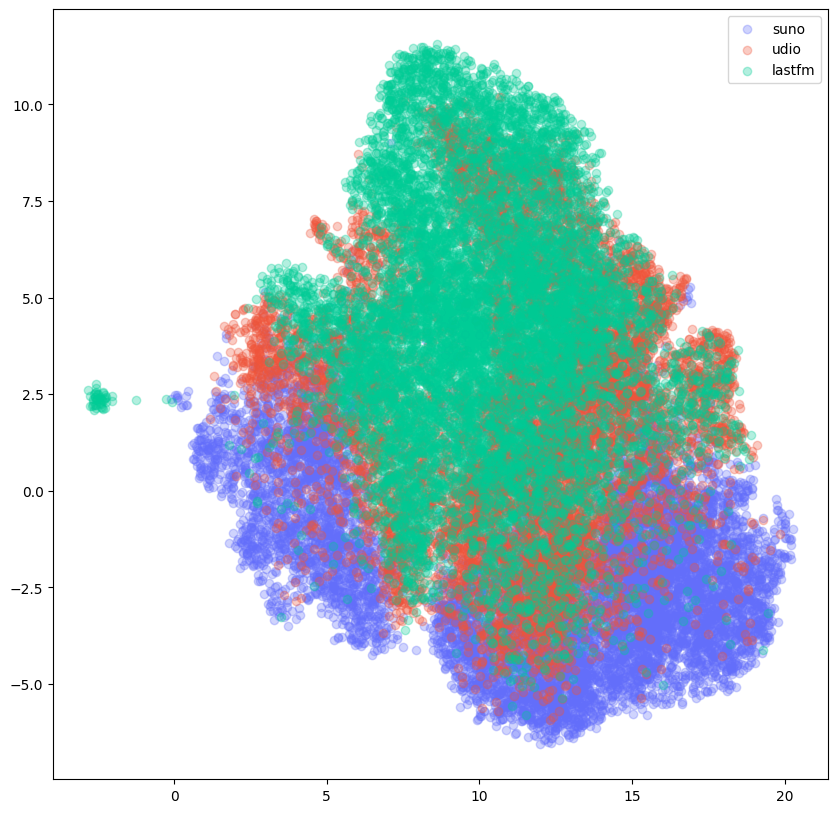

Running UMAP with min_dist=0.9, n_neigh=15, metric=correlation


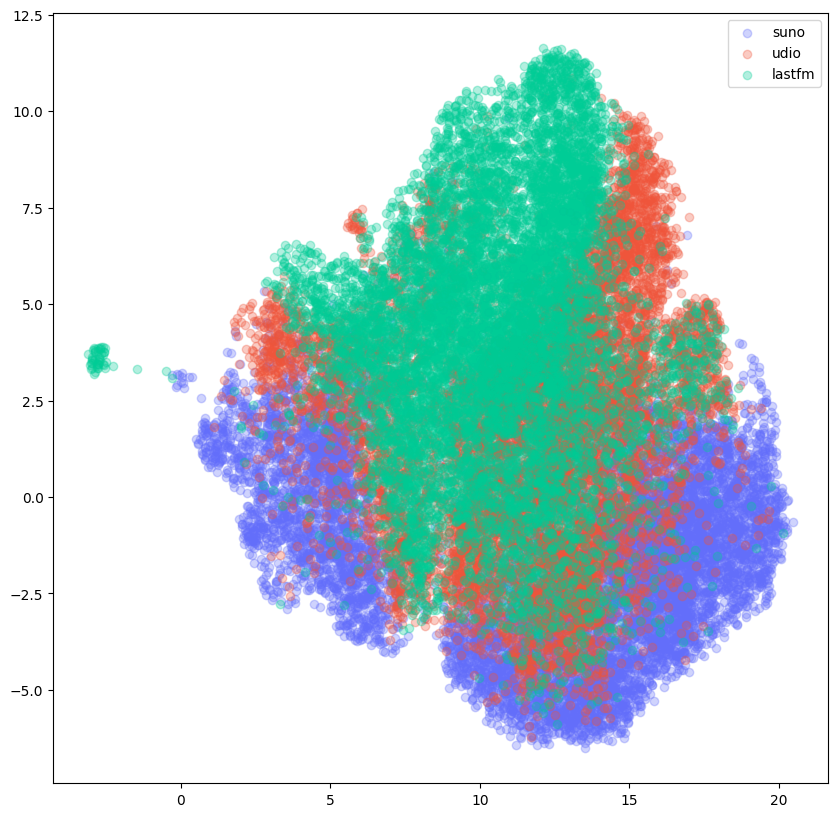

Running UMAP with min_dist=0.9, n_neigh=30, metric=euclidean


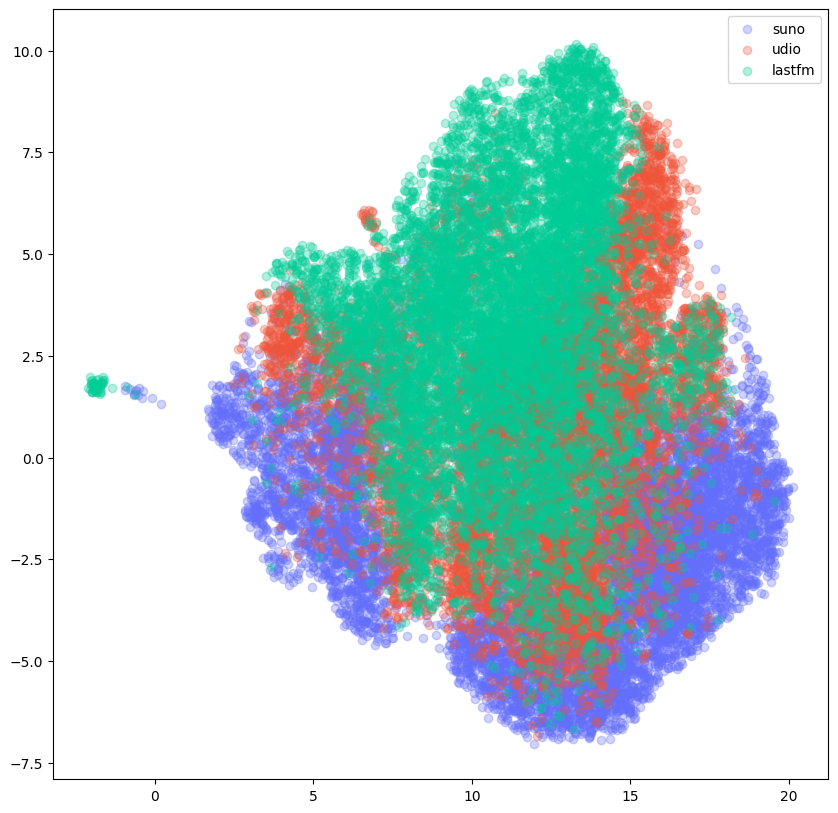

Running UMAP with min_dist=0.9, n_neigh=30, metric=manhattan


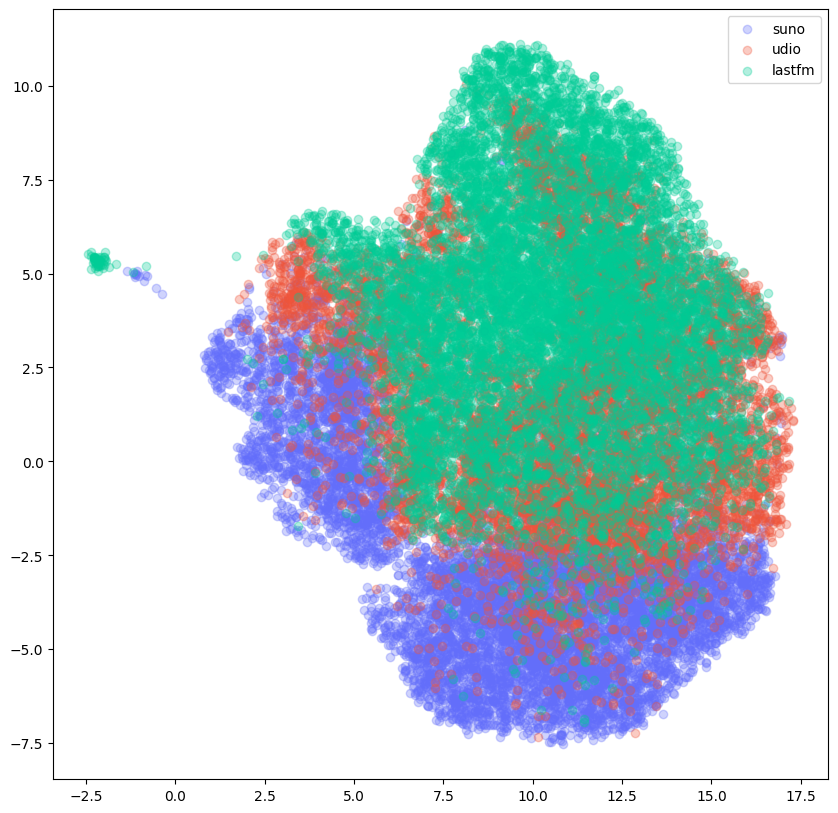

Running UMAP with min_dist=0.9, n_neigh=30, metric=cosine


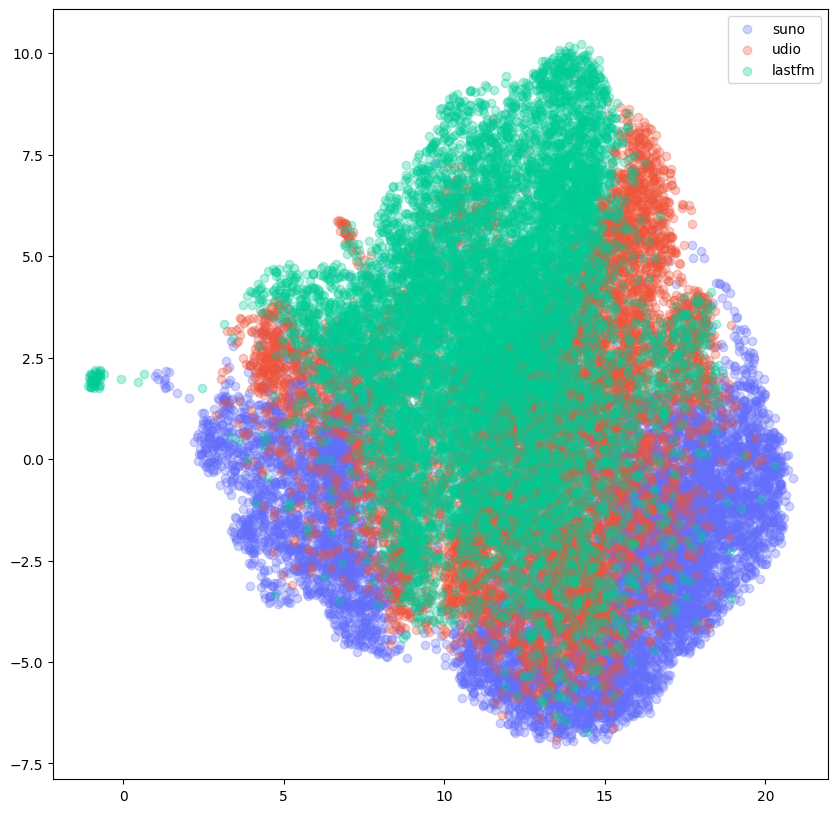

Running UMAP with min_dist=0.9, n_neigh=30, metric=correlation


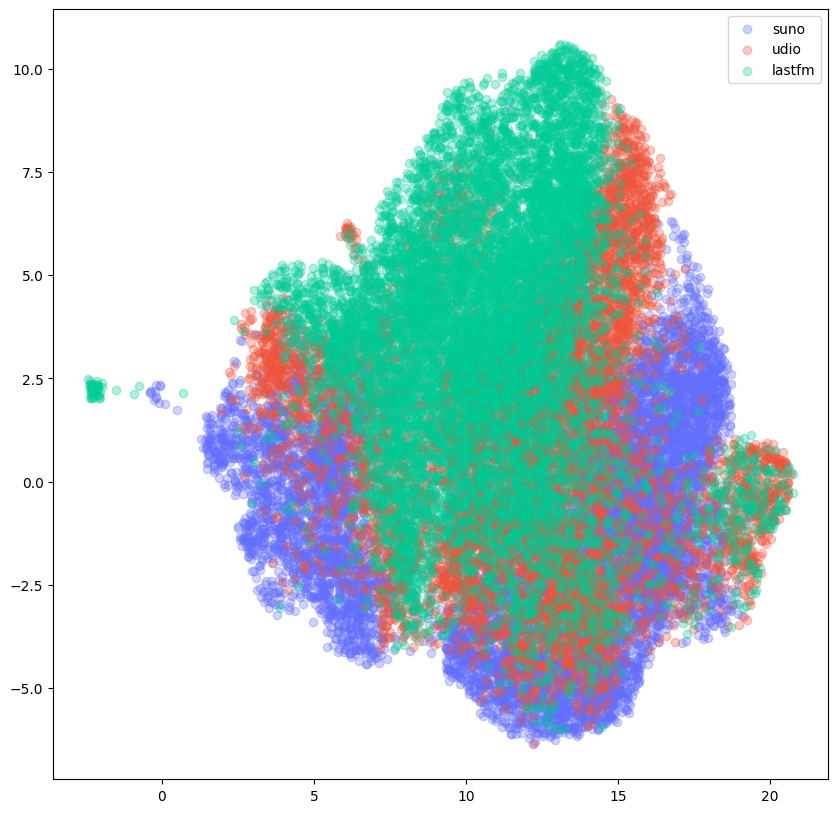

In [ ]:
import matplotlib.pyplot as plt

# min_distances = [0.1, 0.5, 0.9]
# n_neighbors = [5, 15, 30]
# metrics = ['euclidean', 'manhattan', 'cosine', 'correlation']
min_distances = [0.5]
n_neighbors = [15]
metrics = ['manhattan']
# Running UMAP with min_dist=0.5, n_neigh=15, metric=manhattan
for min_dist in min_distances:
    for n_neigh in n_neighbors:
        for metric in metrics:
            print(f'Running UMAP with min_dist={min_dist}, n_neigh={n_neigh}, metric={metric}')
            umap_model = umap.UMAP(n_neighbors=n_neigh, min_dist=min_dist, n_components=2, metric=metric)
            umap_embeddings = umap_model.fit_transform(embeddings)
            # make a dataframe
            df = pd.DataFrame(umap_embeddings, columns=['x', 'y'])
            # add the class labels
            df['label'] = y
            df['audio'] = audio_files
            df['file'] = [f.split('/')[-1] for f in audio_files]
            df['SongID'] = [f.split('/')[-1].split('.')[0] for f in audio_files]
            df['url'] = urls

            hex_colors = [px.colors.qualitative.Plotly[i % len(px.colors.qualitative.Plotly)] for i, label in enumerate(df['label'].unique())]
            # hex_colors = ['#00ff00', '#ff0000', '#0000ff']
            # hex to rgba
            colors = {label: hex_to_rgba(color, alpha=0.3) for label, color in zip(df['label'].unique(), hex_colors)}
            
            # use matplotlib to do the scatterplot
            # plt.figure(figsize=(10, 10))
            # for i, label in enumerate(df['label'].unique()):
            #     plt.scatter(df[df['label'] == label]['x'], df[df['label'] == label]['y'], label=label, alpha=0.3, c=hex_colors[i])
            # plt.legend()
            # plt.show()
            # use plotly to plot with transparency
            fig = px.scatter(df, x='x', y='y', color='label', 
                            color_discrete_map=colors,  # Use our custom color map
                            hover_data=['SongID', 'url'])

            fig.update_traces(marker=dict(size=8)) 
            graph_json = fig.to_json()
            with open('/flask_server/static/graph.json', 'w') as f:
                f.write(graph_json)

            fig.show()

In [6]:
# do the same but with 3d plot
# Running UMAP with min_dist=0.5, n_neigh=15, metric=manhattan
umap_model = umap.UMAP(n_neighbors=15, min_dist=0.5, n_components=3, metric='manhattan')

umap_embeddings = umap_model.fit_transform(embeddings)

# make a dataframe
df = pd.DataFrame(umap_embeddings, columns=['x', 'y', 'z'])
# add the class labels
df['label'] = y
df['audio'] = audio_files
df['file'] = [f.split('/')[-1] for f in audio_files]
df['SongID'] = [f.split('/')[-1].split('.')[0] for f in audio_files]

In [7]:
df['url'] = urls

In [8]:
colors_list = [colors[label] for label in df['label']]
df['colors'] = colors_list
df['colors'].head()

0    rgba(99, 110, 250, 0.3)
1    rgba(99, 110, 250, 0.3)
2    rgba(99, 110, 250, 0.3)
3    rgba(99, 110, 250, 0.3)
4    rgba(99, 110, 250, 0.3)
Name: colors, dtype: object

In [17]:
colors

{'suno': 'rgba(99, 110, 250, 0.3)',
 'udio': 'rgba(239, 85, 59, 0.3)',
 'lastfm': 'rgba(0, 204, 150, 0.3)'}

In [ ]:
# plot and save json
# Ensure the unique labels in df['label'] and color_discrete_map are aligned
unique_labels = df['label'].unique()
hex_colors = [px.colors.qualitative.Plotly[i % len(px.colors.qualitative.Plotly)] for i in range(len(unique_labels))]
colors = {label: hex_colors[i] for i, label in enumerate(unique_labels)}

# Now apply the color map in your 3D plot
fig = px.scatter_3d(df, x='x', y='y', z='z', color='label', color_discrete_map=colors,
                    hover_data=['SongID', 'url'])

# Update the trace for marker size and opacity (alpha)
fig.update_traces(marker=dict(size=5, opacity=0.2))  # Set opacity to 0.3

fig.update_layout(
    width=1000,     # Width of the plot
    height=800,     # Height of the plot
    margin=dict(l=0, r=0, b=0, t=0),  # Reduce margins
    scene=dict(aspectmode='cube')      # Adjust the aspect ratio for better 3D plotting
)

graph_json = fig.to_json()
with open('/flask_server/static/graph3d.json', 'w') as f:
    f.write(graph_json)

fig.show()